In [30]:
import numpy as np
import matplotlib.pyplot as pl
import scanpy as sc

In [35]:
adata

AnnData object with n_obs × n_vars = 15000 × 2000
    obs: 'barcode', 'BC_Seq', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Mt', 'Rb', 'Mt_Rb', 'Condition', 'gender', 'BMI', 'Age', 'S.Score', 'G2M.Score', 'Phase', 'samples', 'RNA_snn_res.0.1', 'RNA_snn_res.0.2', 'RNA_snn_res.0.3', 'RNA_snn_res.0.4', 'RNA_snn_res.0.5', 'RNA_snn_res.0.6', 'RNA_snn_res.0.7', 'RNA_snn_res.0.8', 'RNA_snn_res.0.9', 'RNA_snn_res.1', 'seurat_clusters', 'annotation_heatmap', 'Venous.ECs_signature', 'Arterial.ECs_signature', 'Capillary.ECs_signature', 'Pericytes_signature', 'VSMCs_signature', 'Lymphatic.ECs_signature', 'Activated.ECs_signature', 'Vascular_labels', 'transferred_labels_from_Act', 'ident', 'Size_Factor', 'monocle3_clusters', 'monocle3_partitions', 'monocle3_pseudotime', 'CytoTRACE2_Score', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'cell_bc', 'n_counts', 'leiden', 'palantir_pseudotime', 'palantir_entropy', 'Clusters', '_X', '_Y', 'batch', 'initial_size_unspliced

In [27]:
sc.logging.print_versions()

-----
anndata     0.10.9
scanpy      1.10.2
-----
PIL                         10.4.0
anyio                       NA
asttokens                   NA
attr                        23.1.0
attrs                       23.1.0
babel                       2.11.0
brotli                      1.0.9
certifi                     2024.07.04
cffi                        1.16.0
charset_normalizer          3.3.2
comm                        0.2.1
cycler                      0.12.1
cython_runtime              NA
dateutil                    2.9.0.post0
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
executing                   0.8.3
fastjsonschema              NA
fontTools                   4.53.1
h5py                        3.11.0
idna                        3.7
igraph                      0.11.8
ipykernel                   6.28.0
ipywidgets                  8.1.2
jaraco                      NA
jedi                        0.19.1
jinja2                     

In [2]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
# sc.logging.print_versions()

# low dpi (dots per inch) yields small inline figures
sc.settings.set_figure_params(dpi=300, frameon=False, figsize=(10, 10), facecolor="white")

In [3]:
adata = sc.read_h5ad('/home/mhassan/R_Projects/scAtlas/Analysis/ActivatedECs/Analysis/Pseudotime_InHouse_cytotrace.h5ad')
adata

AnnData object with n_obs × n_vars = 17353 × 47372
    obs: 'barcode', 'BC_Seq', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Mt', 'Rb', 'Mt_Rb', 'Condition', 'gender', 'BMI', 'Age', 'S.Score', 'G2M.Score', 'Phase', 'samples', 'RNA_snn_res.0.1', 'RNA_snn_res.0.2', 'RNA_snn_res.0.3', 'RNA_snn_res.0.4', 'RNA_snn_res.0.5', 'RNA_snn_res.0.6', 'RNA_snn_res.0.7', 'RNA_snn_res.0.8', 'RNA_snn_res.0.9', 'RNA_snn_res.1', 'seurat_clusters', 'annotation_heatmap', 'Venous.ECs_signature', 'Arterial.ECs_signature', 'Capillary.ECs_signature', 'Pericytes_signature', 'VSMCs_signature', 'Lymphatic.ECs_signature', 'Activated.ECs_signature', 'Vascular_labels', 'transferred_labels_from_Act', 'ident', 'Size_Factor', 'monocle3_clusters', 'monocle3_partitions', 'monocle3_pseudotime', 'CytoTRACE2_Score', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'cell_bc'
    var: 'name'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

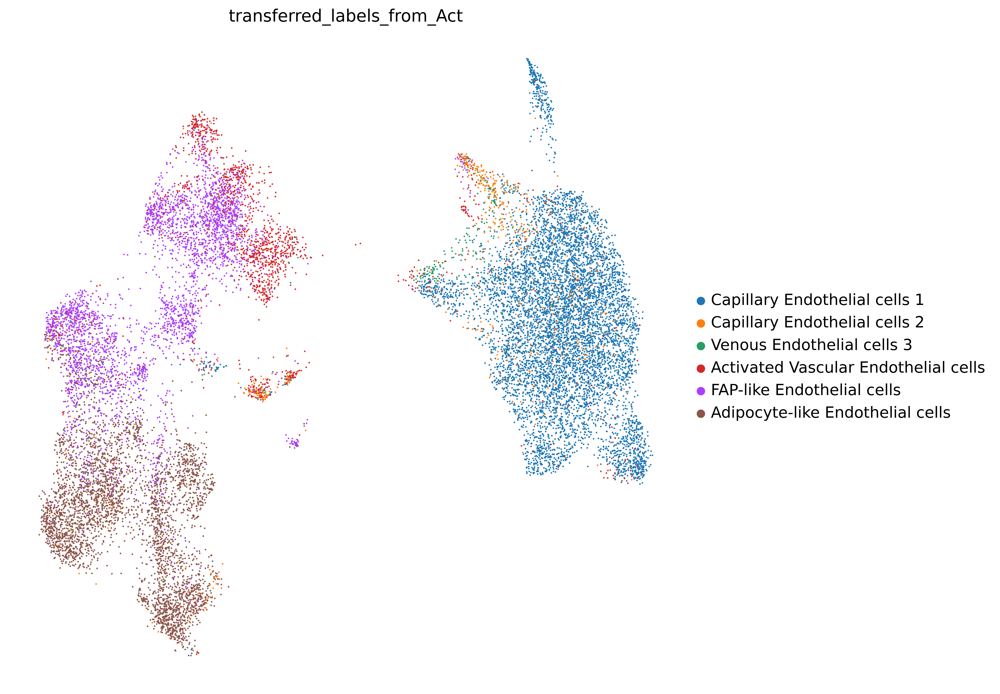

In [4]:
sc.pl.umap(adata, color = 'transferred_labels_from_Act')

In [5]:
# this is not required and results will be comparable without it
adata.X = adata.X.astype("float64")

In [5]:
# first, store the old umap with a new name so it is not overwritten
# adata.obsm['X_umap_old'] = adata.obsm['X_umap']

In [6]:
sc.pp.neighbors(adata, n_pcs = 30, use_rep="X_harmony")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)


# Run PAGA

In [9]:
# use the umap to initialize the graph layout.
sc.tl.draw_graph(adata, init_pos='X_umap')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm) (0:01:17)


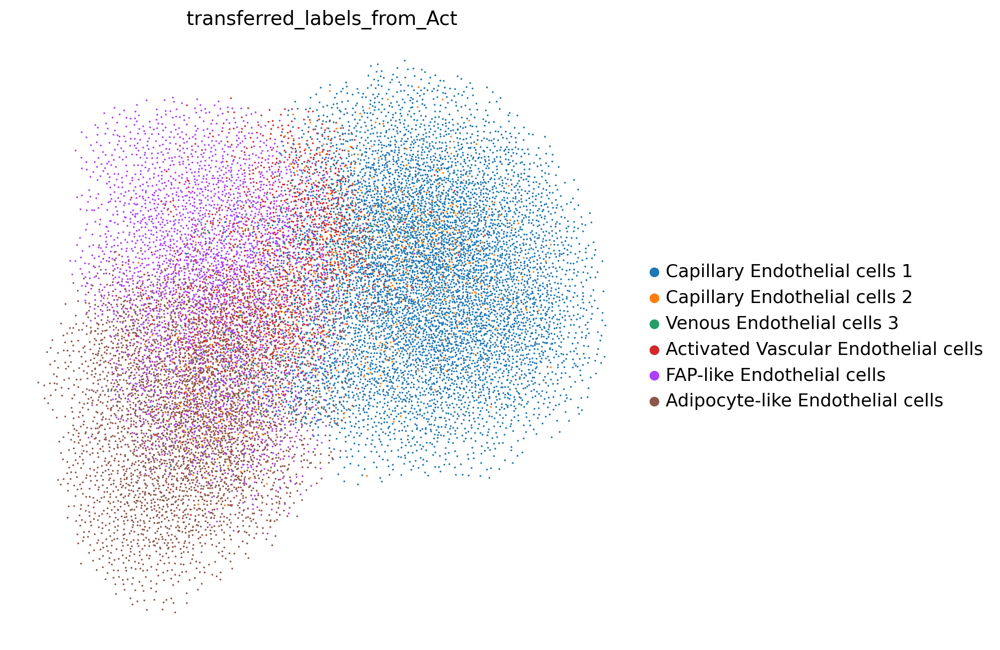

In [13]:
sc.pl.draw_graph(adata, 
                 color='transferred_labels_from_Act')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


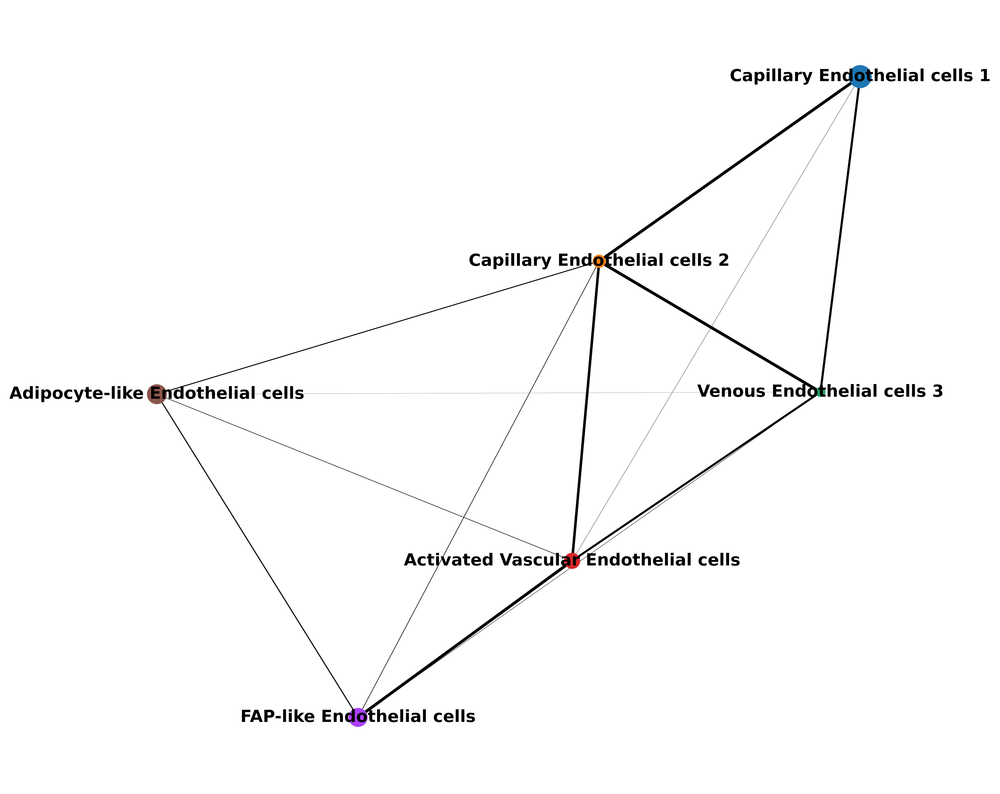

In [7]:
sc.tl.paga(adata, groups='transferred_labels_from_Act')
sc.pl.paga(adata, color='transferred_labels_from_Act', edge_width_scale = 0.3)

--> added 'pos', the PAGA positions (adata.uns['paga'])


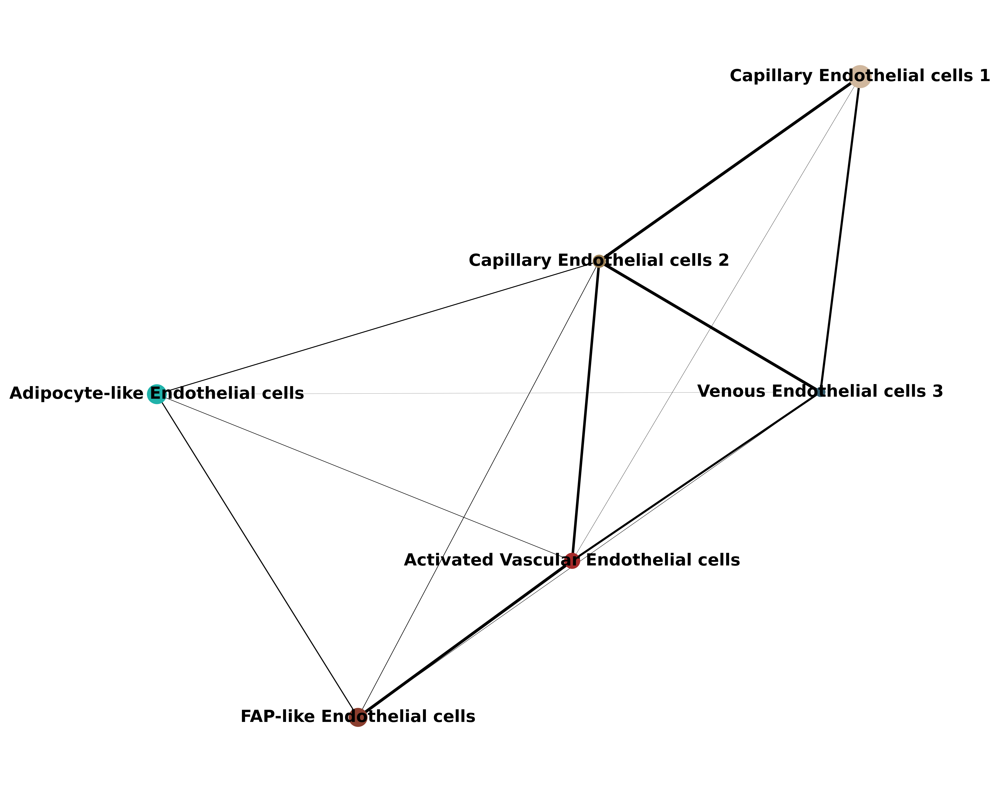

In [19]:
import scanpy as sc

# Ensure your column is categorical
adata.obs['transferred_labels_from_Act'] = adata.obs['transferred_labels_from_Act'].astype('category')

# Define your custom color mapping
mapped_colors = {
    "Capillary Endothelial cells 1": "#D0B79D",
    "Capillary Endothelial cells 2": "#9F8255",
    "Venous Endothelial cells 3": "#335D6F",
    "Activated Vascular Endothelial cells": "#a52a2a",
    "FAP-like Endothelial cells": "#8b3e2f",
    "Adipocyte-like Endothelial cells": "#20b2aa"
}

# Set colors in `adata.uns`
adata.uns['transferred_labels_from_Act_colors'] = [
    mapped_colors[cat] for cat in adata.obs['transferred_labels_from_Act'].cat.categories
]

# Plot PAGA
sc.pl.paga(adata, color='transferred_labels_from_Act', edge_width_scale=0.3, save = 'PAGA_results_nolabels.pdf')

--> added 'pos', the PAGA positions (adata.uns['paga'])


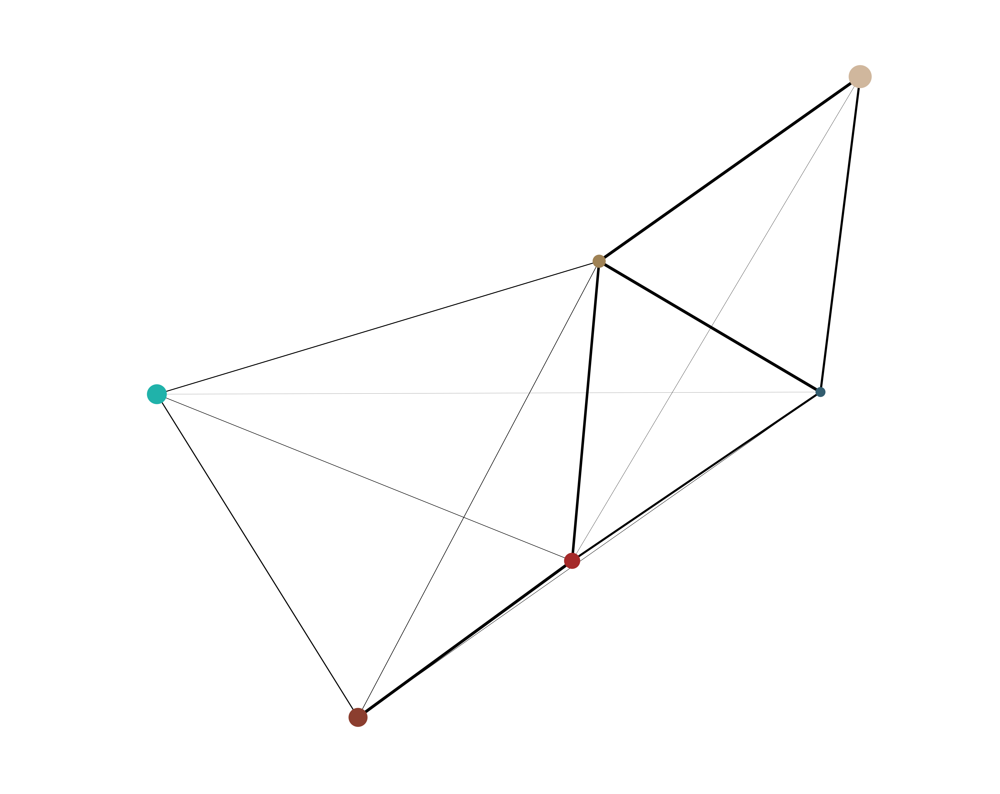

In [25]:
sc.pl.paga(
    adata,
    color='transferred_labels_from_Act',
    edge_width_scale=0.3, text_kwds={"alpha": 0},  # Set transparency to 0 to hide labels
    save = 'PAGA_results_nolabels.pdf'
)

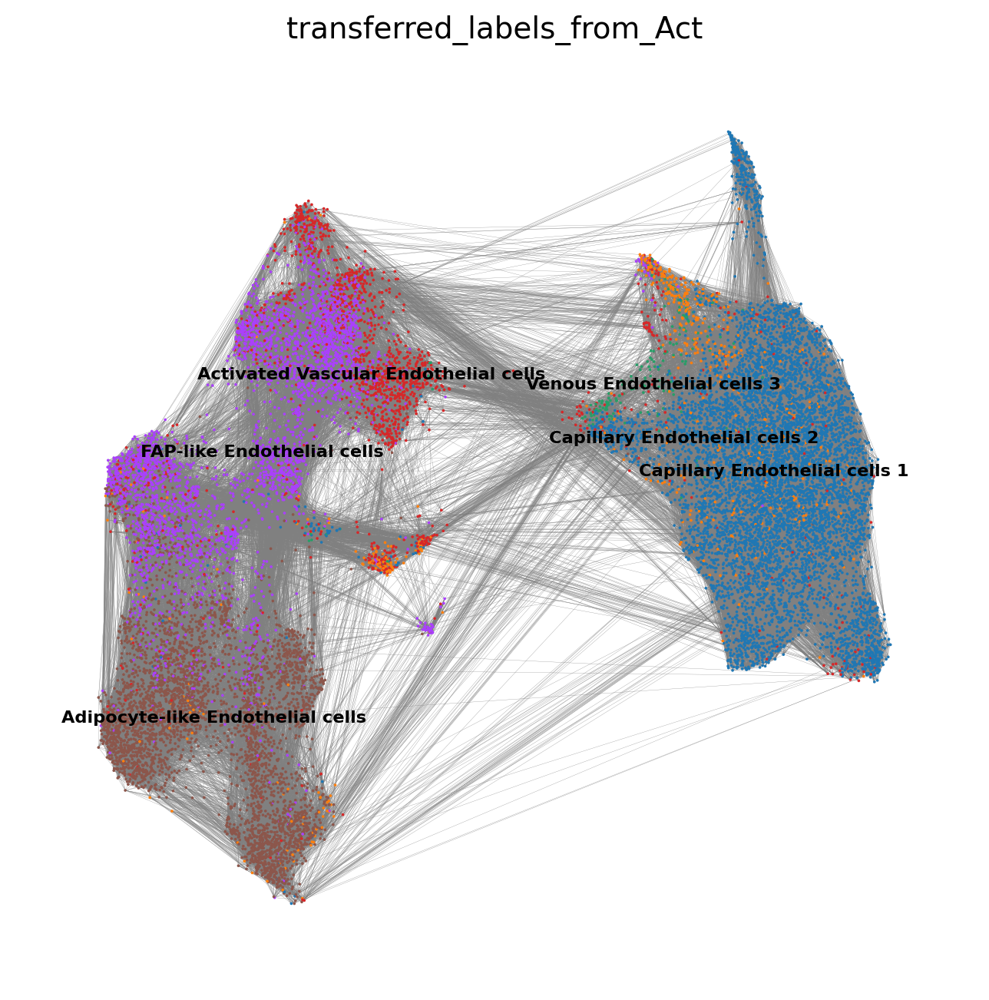

In [15]:
sc.pl.umap(adata, edges=True, color = 'transferred_labels_from_Act', legend_loc= 'on data', legend_fontsize= 'xx-small')

In [31]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['transferred_labels_from_Act']  == 'Capillary Endothelial cells 1')[0]

In [32]:
sc.tl.dpt(adata)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


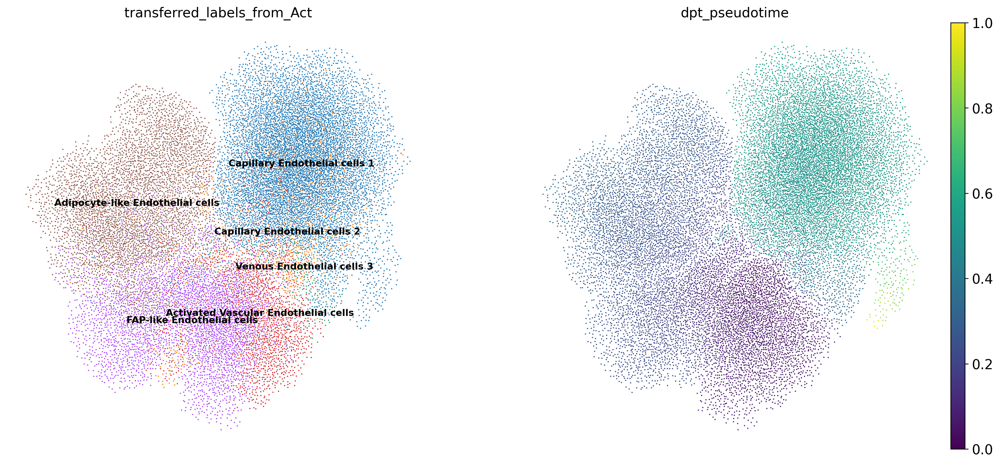

In [33]:
sc.pl.draw_graph(adata, color=['transferred_labels_from_Act', 'dpt_pseudotime'], legend_loc='on data', legend_fontsize= 'x-small')

# Embedding using PAGA-initialization

In [16]:
adata_paga = adata
adata_paga

AnnData object with n_obs × n_vars = 17353 × 47372
    obs: 'barcode', 'BC_Seq', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Mt', 'Rb', 'Mt_Rb', 'Condition', 'gender', 'BMI', 'Age', 'S.Score', 'G2M.Score', 'Phase', 'samples', 'RNA_snn_res.0.1', 'RNA_snn_res.0.2', 'RNA_snn_res.0.3', 'RNA_snn_res.0.4', 'RNA_snn_res.0.5', 'RNA_snn_res.0.6', 'RNA_snn_res.0.7', 'RNA_snn_res.0.8', 'RNA_snn_res.0.9', 'RNA_snn_res.1', 'seurat_clusters', 'annotation_heatmap', 'Venous.ECs_signature', 'Arterial.ECs_signature', 'Capillary.ECs_signature', 'Pericytes_signature', 'VSMCs_signature', 'Lymphatic.ECs_signature', 'Activated.ECs_signature', 'Vascular_labels', 'transferred_labels_from_Act', 'ident', 'Size_Factor', 'monocle3_clusters', 'monocle3_partitions', 'monocle3_pseudotime', 'CytoTRACE2_Score', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'cell_bc'
    var: 'name'
    uns: 'transferred_labels_from_Act_colors', 'neighbors', 'draw_graph', 'paga', 'transferred_labels_fro

In [17]:
sc.tl.draw_graph(adata_paga, init_pos='paga')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm) (0:05:00)


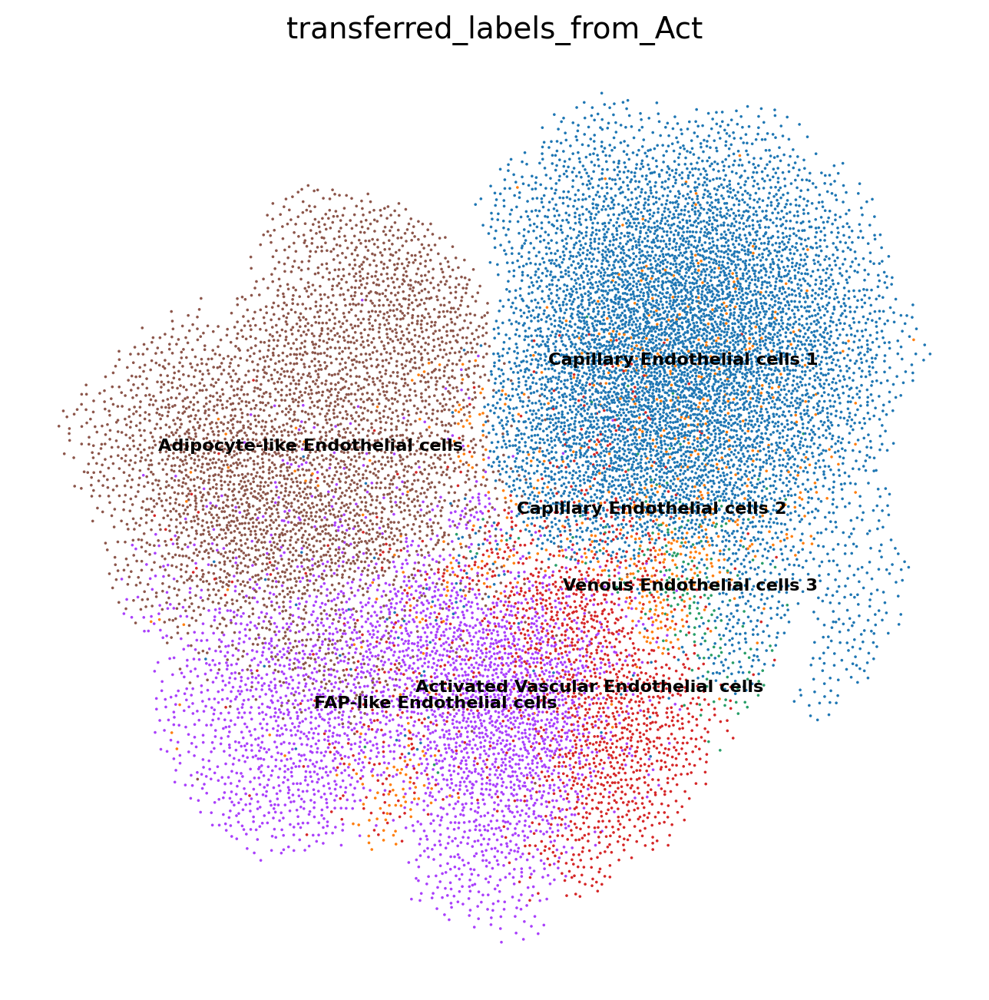

In [18]:
sc.pl.draw_graph(adata_paga, color=['transferred_labels_from_Act'], legend_loc='on data', legend_fontsize=  'xx-small')

In [19]:
adata.obs['transferred_labels_from_Act']

SAT9:TCCCACATCAGCACCGx           FAP-like Endothelial cells
SAT9:CATGAGTCACTACAGTx           FAP-like Endothelial cells
SAT9:GGTGGCTCAGTCTCTCx           FAP-like Endothelial cells
SAT9:ACCCTTGCAATGCTCAx           FAP-like Endothelial cells
SAT9:ATCCATTTCCGTGTCTx     Adipocyte-like Endothelial cells
                                         ...               
SAT60:CTCAAGAGTAGGAAAGx          FAP-like Endothelial cells
SAT60:GTATTTCGTATCAGCTx       Capillary Endothelial cells 1
SAT60:CCAAGCGGTGGCTACCx       Capillary Endothelial cells 1
SAT60:ACTGTCCAGTGAGTTAx          FAP-like Endothelial cells
SAT60:ACGTTCCCAACCCGCAx       Capillary Endothelial cells 1
Name: transferred_labels_from_Act, Length: 17353, dtype: category
Categories (6, object): ['Capillary Endothelial cells 1', 'Capillary Endothelial cells 2', 'Venous Endothelial cells 3', 'Activated Vascular Endothelial cells', 'FAP-like Endothelial cells', 'Adipocyte-like Endothelial cells']

# Gene changes

In [20]:
adata_paga.uns['iroot'] = np.flatnonzero(adata_paga.obs['transferred_labels_from_Act']  == 'Capillary Endothelial cells 1')[0]

In [21]:
sc.tl.dpt(adata_paga)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9971862  0.9866708  0.984343   0.9765572  0.9653873
     0.96336937 0.9582079  0.95643806 0.95206356 0.9498068  0.9490631
     0.9417978  0.94024855 0.93880165]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


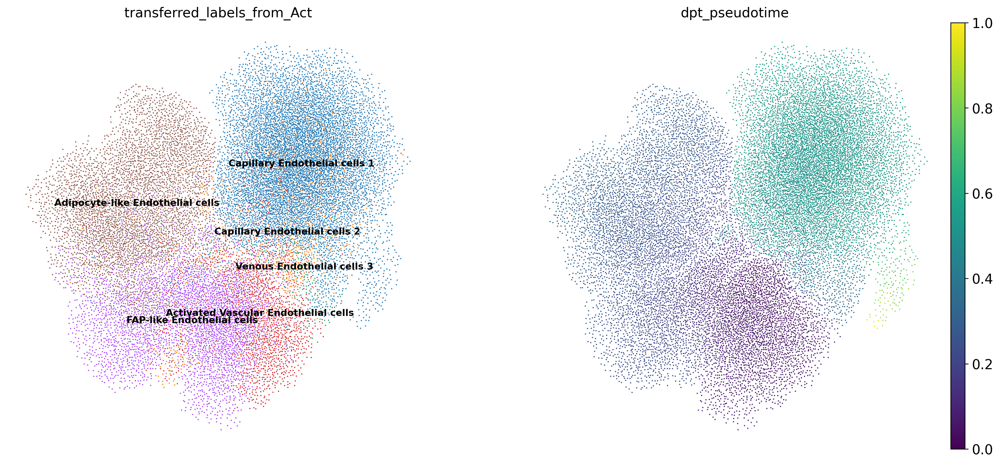

In [22]:
sc.pl.draw_graph(adata_paga, color=['transferred_labels_from_Act', 'dpt_pseudotime'], legend_loc='on data', legend_fontsize= 'x-small')

--> added 'pos', the PAGA positions (adata.uns['paga'])


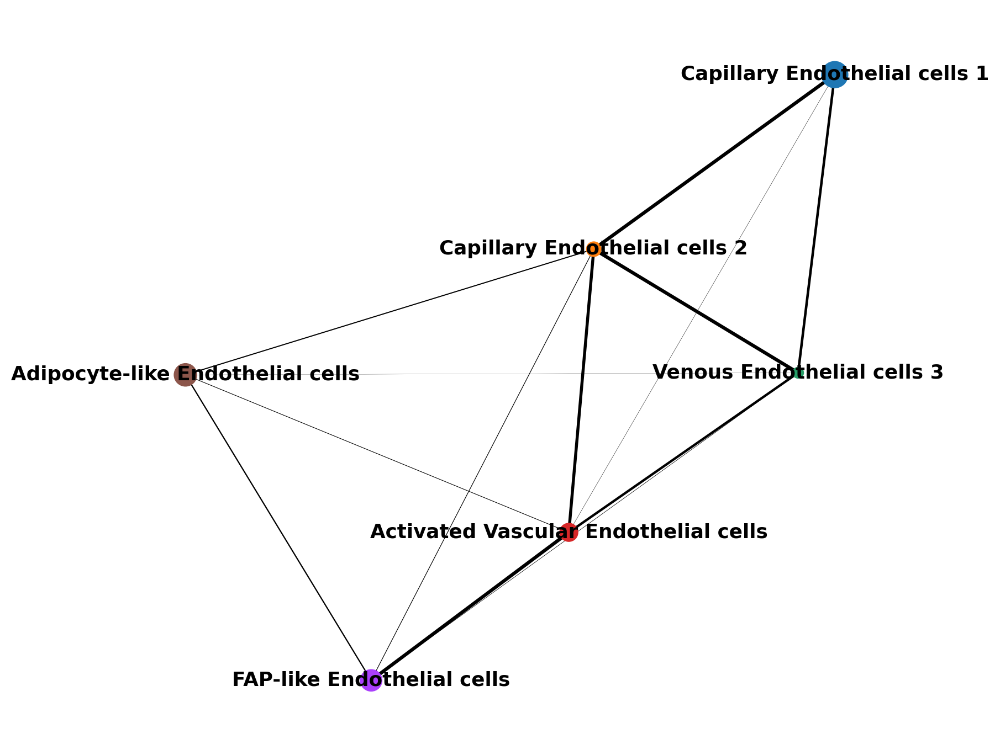

In [36]:
sc.pl.paga(adata_paga, color='transferred_labels_from_Act', edge_width_scale = 0.3)

In [ ]:
# setting Adipocyte like as root

In [24]:
adata_paga.uns['iroot'] = np.flatnonzero(adata_paga.obs['transferred_labels_from_Act']  == 'Adipocyte-like Endothelial cells')[0]

In [25]:
sc.tl.dpt(adata_paga)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


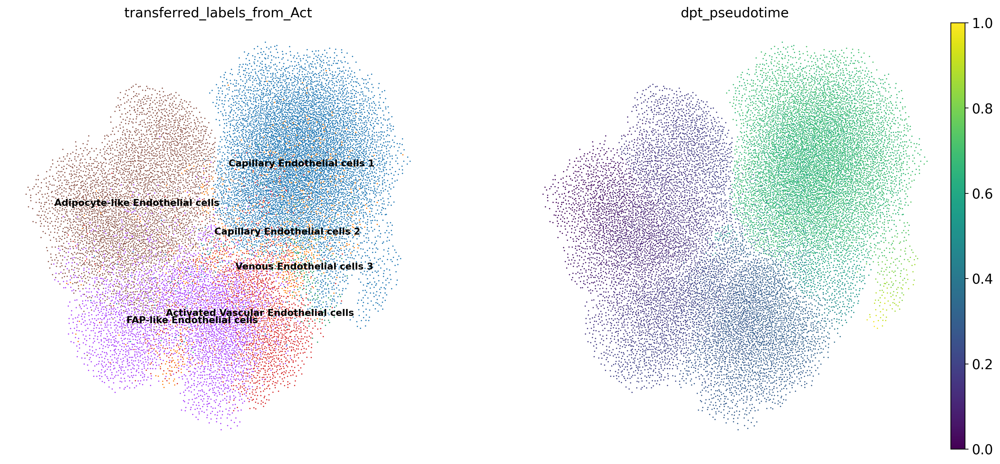

In [26]:
sc.pl.draw_graph(adata_paga, color=['transferred_labels_from_Act', 'dpt_pseudotime'], legend_loc='on data', legend_fontsize= 'x-small')

In [27]:
adata.obs

,barcode,BC_Seq,orig.ident,nCount_RNA,nFeature_RNA,Mt,Rb,Mt_Rb,Condition,gender,...,Size_Factor,monocle3_clusters,monocle3_partitions,monocle3_pseudotime,CytoTRACE2_Score,CytoTRACE2_Relative,preKNN_CytoTRACE2_Score,preKNN_CytoTRACE2_Potency,cell_bc,dpt_pseudotime
SAT9:TCCCACATCAGCACCGx,TCCCACATCAGCACCG-1_1_1,TCCCACATCAGCACCG,SAT9,24663.0,6466,0.067069,0.205152,0.272222,Obese,female,...,24663.0,3,2,19.918240,0.135583,0.873934,1.252407e-01,Differentiated,SAT9:TCCCACATCAGCACCGx,0.138979
SAT9:CATGAGTCACTACAGTx,CATGAGTCACTACAGT-1_1_1,CATGAGTCACTACAGT,SAT9,21270.0,6250,0.117786,0.724835,0.842620,Obese,female,...,21270.0,3,2,21.823450,0.144297,0.953435,1.439026e-01,Differentiated,SAT9:CATGAGTCACTACAGTx,0.153465
SAT9:GGTGGCTCAGTCTCTCx,GGTGGCTCAGTCTCTC-1_1_1,GGTGGCTCAGTCTCTC,SAT9,20271.0,6175,0.080749,0.375243,0.455992,Obese,female,...,20271.0,4,2,15.385648,0.105799,0.644047,7.077652e-02,Differentiated,SAT9:GGTGGCTCAGTCTCTCx,0.265730
SAT9:ACCCTTGCAATGCTCAx,ACCCTTGCAATGCTCA-1_1_1,ACCCTTGCAATGCTCA,SAT9,16627.0,5141,0.064177,0.472579,0.536756,Obese,female,...,16627.0,4,2,13.788428,0.102294,0.618084,9.594792e-02,Differentiated,SAT9:ACCCTTGCAATGCTCAx,0.260063
SAT9:ATCCATTTCCGTGTCTx,ATCCATTTCCGTGTCT-1_1_1,ATCCATTTCCGTGTCT,SAT9,15328.0,5062,0.000000,0.081694,0.081694,Obese,female,...,15328.0,3,2,25.177651,0.131904,0.844197,1.564402e-01,Differentiated,SAT9:ATCCATTTCCGTGTCTx,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAT60:CTCAAGAGTAGGAAAGx,CTCAAGAGTAGGAAAG-1_14_1,CTCAAGAGTAGGAAAG,SAT60,320.0,299,0.000000,0.000000,0.000000,Lean,male,...,320.0,8,3,21.406017,0.144692,0.956057,1.000000e-08,Differentiated,SAT60:CTCAAGAGTAGGAAAGx,0.424130
SAT60:GTATTTCGTATCAGCTx,GTATTTCGTATCAGCT-1_14_1,GTATTTCGTATCAGCT,SAT60,495.0,332,0.000000,0.200000,0.200000,Lean,male,...,495.0,2,1,0.070207,0.109978,0.678020,6.990987e-02,Differentiated,SAT60:GTATTTCGTATCAGCTx,0.674517
SAT60:CCAAGCGGTGGCTACCx,CCAAGCGGTGGCTACC-1_14_1,CCAAGCGGTGGCTACC,SAT60,472.0,317,0.000000,0.627615,0.627615,Lean,male,...,472.0,1,1,0.077120,0.077373,0.460523,9.723827e-02,Differentiated,SAT60:CCAAGCGGTGGCTACCx,0.629576
SAT60:ACTGTCCAGTGAGTTAx,ACTGTCCAGTGAGTTA-1_14_1,ACTGTCCAGTGAGTTA,SAT60,385.0,358,0.000000,0.000000,0.000000,Lean,male,...,385.0,8,3,21.406017,0.149863,0.977639,1.666667e-01,Differentiated,SAT60:ACTGTCCAGTGAGTTAx,0.466346


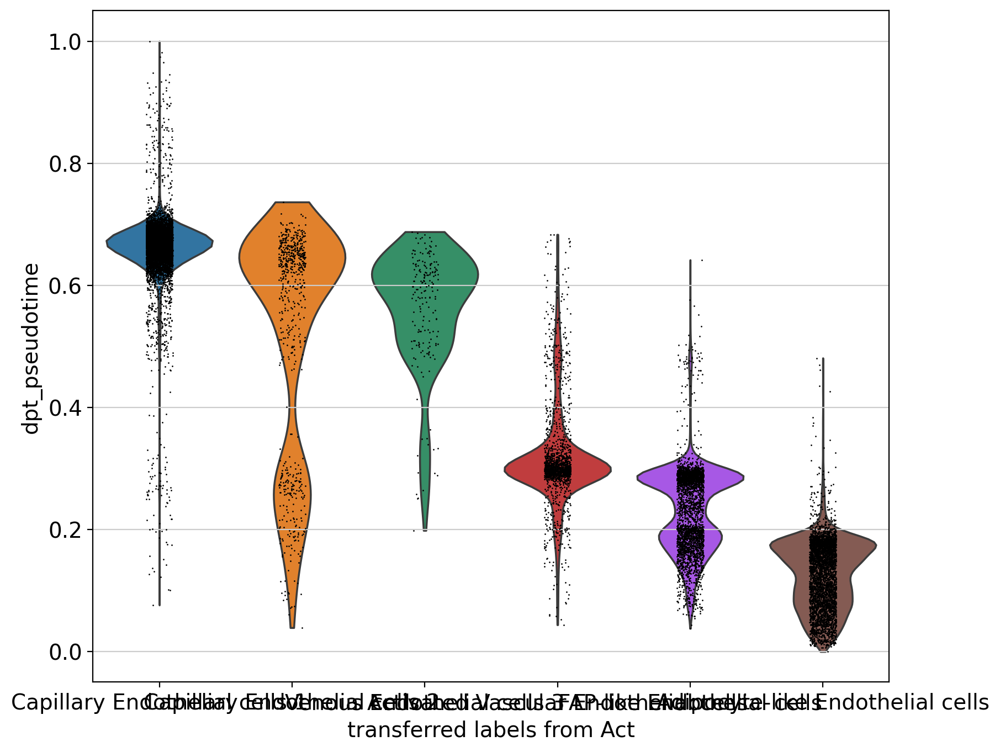

In [29]:
sc.pl.violin(adata, groupby='transferred_labels_from_Act', keys='dpt_pseudotime')